# Vehicle Detection Project

The goals / steps of this project are the following:

* Perform a Histogram of Oriented Gradients (HOG) feature extraction on a labeled training set of images and train a classifier Linear SVM classifier
* Optionally, you can also apply a color transform and append binned color features, as well as histograms of color, to your HOG feature vector. 
* Note: for those first two steps don't forget to normalize your features and randomize a selection for training and testing.
* Implement a sliding-window technique and use your trained classifier to search for vehicles in images.
* Run your pipeline on a video stream (start with the test_video.mp4 and later implement on full project_video.mp4) and create a heat map of recurring detections frame by frame to reject outliers and follow detected vehicles.
* Estimate a bounding box for vehicles detected.

## Train a classifier

Implement a binary classifier for indentifying whether an image belongs to either the vehicles or the non-vehicles classes.

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from skimage.feature import hog
from sklearn.metrics import f1_score
from sklearn.svm import LinearSVC

##### Data Exploration

In [2]:
# Get the training data files, both possitive (vehicles) and negative (non-vehicles) classes.
def get_training_data_files():
    
    # Create a list with all the image files that belong to the vehicle class.
    car_files = glob.glob('./vehicles/GTI_Far/*.png')
    car_files += glob.glob('./vehicles/GTI_Left/*.png')
    car_files += glob.glob('./vehicles/GTI_MiddleClose/*.png')
    car_files += glob.glob('./vehicles/GTI_Right/*.png')
    car_files += glob.glob('./vehicles/KITTI_extracted/*.png')
    
    # Create a list with all the image files that belong to the non-vehicle class.
    not_car_files = glob.glob('./non-vehicles/Extras/*.png')
    not_car_files += glob.glob('./non-vehicles/GTI/*.png')
    
    return car_files, not_car_files

In [3]:
# Load an image in RGB. 
# Using cv2 is preferable because it is more consistent in the read data format 
# when reading different types of files.
# The output will be an RGB image in the (0, 255) range
def image_read(file_name):
    image = cv2.imread(file_name)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)    
    return image

In [4]:
car_files, not_car_files = get_training_data_files()

# Check if the dataset for both classes are balanced
print('Samples in vehicle set: ', len(car_files))
print('Samples in non-vehicles set: ', len(not_car_files))

Samples in vehicle set:  8792
Samples in non-vehicles set:  8968


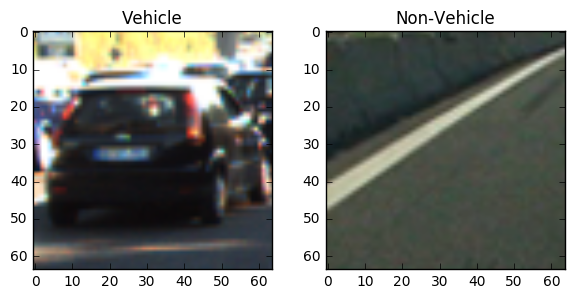

In [73]:
%matplotlib inline

# Choose a random sample
image = image_read(np.random.choice(car_files))

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(6, 3))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Vehicle')

image = image_read(np.random.choice(not_car_files))
ax2.imshow(image)
ax2.set_title('Non-Vehicle')

plt.savefig('./output_images/car_not_car.png', transparent=True)

#### utility functions to extract features

In [8]:
from skimage.feature import hog

# Define a function to compute binned color features  
def bin_spatial(img, size=(32, 32)):
    # Use cv2.resize().ravel() to create the feature vector
    features = cv2.resize(img, size).ravel() 
    # Return the feature vector
    return features

# Define a function to compute color histogram features 
def color_hist(img, nbins=32, bins_range=(0, 256)):
    # Compute the histogram of the color channels separately
    channel1_hist = np.histogram(img[:,:,0], bins=nbins, range=bins_range)
    channel2_hist = np.histogram(img[:,:,1], bins=nbins, range=bins_range)
    channel3_hist = np.histogram(img[:,:,2], bins=nbins, range=bins_range)
    # Concatenate the histograms into a single feature vector
    hist_features = np.concatenate((channel1_hist[0], channel2_hist[0], channel3_hist[0]))
    
    return hist_features

# Convert between RGB and other color space
def convert_color(image, color_space):
    # apply color conversion if other than 'RGB'
    if color_space != 'RGB':
        if color_space == 'HSV':
            cvt_image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
        elif color_space == 'LUV':
            cvt_image = cv2.cvtColor(image, cv2.COLOR_RGB2LUV)
        elif color_space == 'HLS':
            cvt_image = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
        elif color_space == 'YUV':
            cvt_image = cv2.cvtColor(image, cv2.COLOR_RGB2YUV)
        elif color_space == 'YCrCb':
            cvt_image = cv2.cvtColor(image, cv2.COLOR_RGB2YCrCb)
    else: 
        cvt_image = np.copy(image)
        
    return cvt_image
    
# Define a function to return HOG features and visualization
def get_hog_features(image, orient, pix_per_cell, cell_per_block, 
                      vis=False, feature_vec=True):
    # Call with two outputs if vis==True
    if vis == True:
        features, hog_image = hog(image, orientations=orient, 
                                  pixels_per_cell=(pix_per_cell, pix_per_cell),
                                  cells_per_block=(cell_per_block, cell_per_block), 
                                  transform_sqrt=True, 
                                  visualise=vis, feature_vector=feature_vec)
        return features, hog_image
    # Otherwise call with one output
    else:      
        features = hog(image, orientations=orient, 
                       pixels_per_cell=(pix_per_cell, pix_per_cell),
                       cells_per_block=(cell_per_block, cell_per_block), 
                       transform_sqrt=True, 
                       visualise=vis, feature_vector=feature_vec)
        return features
    
    
# Define a function to extract hog features from a single image
# Have this function call bin_spatial(), color_hist() and get_hog_features()
def extract_features(image, color_space='RGB', spatial_size=(32, 32),
                     hist_bins=32, orient=9,
                     pix_per_cell=8, cell_per_block=2, hog_channel=0,
                     spatial_feat=True, hist_feat=True, hog_feat=True):

    # Iterate through the list of images
    features = []

    feature_image = convert_color(image, color_space)    

    if spatial_feat == True:
        spatial_features = bin_spatial(feature_image, size=spatial_size)
        features.append(spatial_features)
    if hist_feat == True:
        # Apply color_hist()
        hist_features = color_hist(feature_image, nbins=hist_bins)
        features.append(hist_features)
    if hog_feat == True:
        # Call get_hog_features() with vis=False, feature_vec=True
        if hog_channel == 'ALL':
            hog_features = []
            for channel in range(feature_image.shape[2]):
                hog_features.append(get_hog_features(feature_image[:,:,channel], 
                                    orient, pix_per_cell, cell_per_block, 
                                    vis=False, feature_vec=True))
            hog_features = np.ravel(hog_features)        
        else:
            hog_features = get_hog_features(feature_image[:,:,hog_channel], orient, 
                                            pix_per_cell, cell_per_block,
                                            vis=False, feature_vec=True)
        # Append the new feature vector to the features list
        features.append(hog_features)
            
    # Return a feature vector
    return np.concatenate(features)

# Define a function to extract features from a list of images
# Have this function call extract_features()
def extract_features_multiple(images, color_space='RGB', spatial_size=(32, 32),
                              hist_bins=32, orient=9,
                              pix_per_cell=8, cell_per_block=2, hog_channel=0,
                              spatial_feat=True, hist_feat=True, hog_feat=True):
    # Create a list to append feature vectors to
    features = []
    # Iterate through the list of images
    for image in images:
        img_features = extract_features(image, color_space=color_space, spatial_size=spatial_size,
                                         hist_bins=hist_bins, orient=orient,
                                         pix_per_cell=pix_per_cell, cell_per_block=cell_per_block,
                                         hog_channel=hog_channel,
                                         spatial_feat=spatial_feat, hist_feat=hist_feat, hog_feat=hog_feat)
        features.append(img_features)
    # Return list of feature vectors
    return features

Features per channel: (1764,)


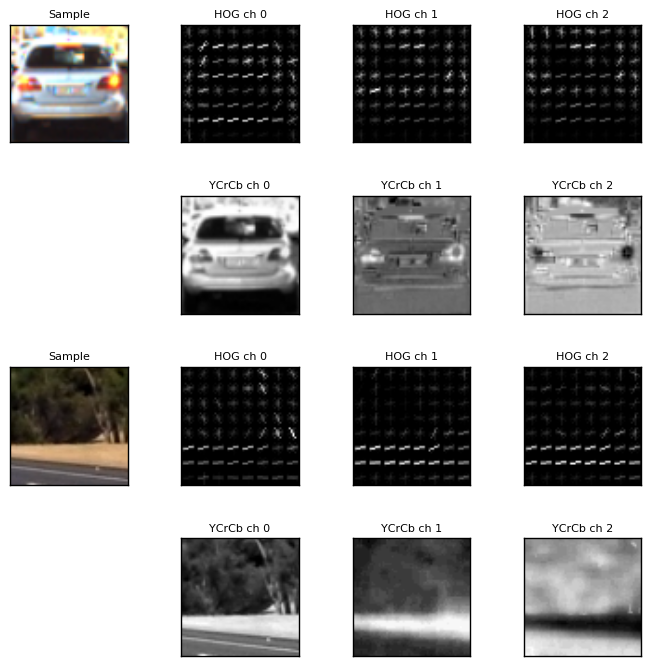

In [76]:
# Visualize a sample image and its hog features

fig, axes = plt.subplots(4, 4, figsize=(7, 7))
fig.tight_layout()

for k in range(0,2):
    if k % 2 == 0:
        image = image_read(np.random.choice(car_files))
    else:
        image = image_read(np.random.choice(not_car_files)) 

    feat_image = convert_color(image, 'YCrCb')

    axes[k*2,0].imshow(image)
    axes[k*2,0].set_title('Sample', fontsize=8)
    axes[k*2,0].set_xticks([])
    axes[k*2,0].set_yticks([])

    for i in range(0,3):

        feat, visualization = get_hog_features(feat_image[:,:,i], orient=9, pix_per_cell=8, cell_per_block=2, 
                                               vis=True, feature_vec=True)

        axes[k*2,i+1].imshow(visualization, cmap='gray')
        axes[k*2,i+1].set_title('HOG ch {}'.format(i), fontsize=8)
        axes[k*2,i+1].set_xticks([])
        axes[k*2,i+1].set_yticks([])

    fig.delaxes(axes[k*2+1,0])

    for i in range(0,3):
        axes[k*2+1,i+1].imshow(feat_image[:,:,i], cmap='gray')
        axes[k*2+1,i+1].set_title('YCrCb ch {}'.format(i), fontsize=8)
        axes[k*2+1,i+1].set_xticks([])
        axes[k*2+1,i+1].set_yticks([])
        
plt.savefig('./output_images/HOG_example.png', transparent=True)

print("Features per channel:", feat.shape)

### Classifier selection

In [8]:
# Cache images to make feature extraction faster
car_images = [image_read(img) for img in car_files]
not_car_images = [image_read(img) for img in not_car_files]

print(len(car_images), car_images[0].shape)
print(len(not_car_images), not_car_images[0].shape)

8792 (64, 64, 3)
8968 (64, 64, 3)


In [9]:
image_dataset = np.vstack((car_images, not_car_images))

# Create labels [1,0] for each class
labels = np.hstack((np.ones(len(car_files)), np.zeros(len(not_car_files))))

# Split Training/Test sets
rand_state = np.random.randint(0, 100)
X_train, X_test, y_train, y_test = train_test_split(image_dataset, labels, test_size=0.2, stratify=labels, 
                                                    random_state=rand_state)

print("Number of training samples:",len(X_train))
print("Number of test samples:", len(X_test))

Number of training samples: 14208
Number of test samples: 3552


 Evaluate the accuracy and preccision-recall performace with the F1 score for different features.

In [13]:
# Evaluate color spaces for HOG features, keeping other parameters fixed.

color_spaces = ['YCrCb','YUV', 'HLS', 'LUV', 'HSV', 'RGB']
orient = 9
pix_per_cell = 8
cell_per_block = 2
hog_channel = 'ALL'

for i, color_space in enumerate(color_spaces):
    
    X_train_f = extract_features_multiple(X_train, color_space=color_space, orient=orient, 
                                          pix_per_cell=pix_per_cell, cell_per_block=cell_per_block, 
                                          hog_channel=hog_channel, 
                                          spatial_feat=False, hist_feat=False, hog_feat=True)

    X_test_f = extract_features_multiple(X_test, color_space=color_space, orient=orient, 
                                         pix_per_cell=pix_per_cell, cell_per_block=cell_per_block, 
                                         hog_channel=hog_channel, 
                                         spatial_feat=False, hist_feat=False, hog_feat=True)

    # Convert the lists to numpy arrays where eatch row is a sample array of features
    X_train_f = np.asarray(X_train_f).astype(np.float64)
    X_test_f = np.asarray(X_test_f).astype(np.float64)
    
    clf = LinearSVC()
    # Train classifier
    clf.fit(X_train_f, y_train)
    # Predict the test set labels
    y_p = clf.predict(X_test_f)
    # Calculate F1 and Accuracy
    f1 = f1_score(y_test, y_p)
    acc = clf.score(X_test_f, y_test)
    
    if i == 0:
        print('number of train samples', X_train_f.shape[0])
        print('numer of features:', X_test_f.shape[1])
        print('number of test samples', X_test_f.shape[0])
        print('color space\t Accuracy\t \tF1')
    
    print('{}\t \t {:.6f}\t  {:.6f}'.format(color_space, acc, f1))

number of train samples 14208
numer of features: 5292
number of test samples 3552
color space	 Accuracy	 	F1
YCrCb	 	 0.990146	  0.990054
YUV	 	 0.987613	  0.987464
HLS	 	 0.987331	  0.987183
LUV	 	 0.988739	  0.988597
HSV	 	 0.985923	  0.985779
RGB	 	 0.973255	  0.972772


In [15]:
# Evaluate different number of orientation bins for HOG features, keeping other parameters fixed.
color_space = 'YCrCb'
orients = [5,7,9,10]
pix_per_cell = 8
cell_per_block = 2
hog_channel = 'ALL'
rand_state = np.random.randint(0, 100)
for i, orient in enumerate(orients):
    
    X_train_f = extract_features_multiple(X_train, color_space=color_space, orient=orient, 
                                          pix_per_cell=pix_per_cell, cell_per_block=cell_per_block, 
                                          hog_channel=hog_channel, 
                                          spatial_feat=False, hist_feat=False, hog_feat=True)

    X_test_f = extract_features_multiple(X_test, color_space=color_space, orient=orient, 
                                         pix_per_cell=pix_per_cell, cell_per_block=cell_per_block, 
                                         hog_channel=hog_channel, 
                                         spatial_feat=False, hist_feat=False, hog_feat=True)
    
    # Convert the lists to numpy arrays where eatch row is a sample array of features
    X_train_f = np.asarray(X_train_f).astype(np.float64)
    X_test_f = np.asarray(X_test_f).astype(np.float64)
    
    clf = LinearSVC()
    # Train classifier
    clf.fit(X_train_f, y_train)
    # Predict the test set labels
    y_p = clf.predict(X_test_f)
    # Calculate F1 and Accuracy
    f1 = f1_score(y_test, y_p)
    acc = clf.score(X_test_f, y_test)     

    if i == 0:
        print('number of train samples', X_train_f.shape[0])
        print('number of test samples', X_test_f.shape[0])
        print('orients \t features\t Accuracy\t \tF1')
    
    print('{}\t \t {}\t   {:.6f}\t  \t{:.6f}'.format(orient, X_train_f.shape[1], acc, f1))

number of train samples 14208
number of test samples 3552
orients 	 features	 Accuracy	 	F1
5	 	 2940	   0.984234	  	0.984036
7	 	 4116	   0.988457	  	0.988349
9	 	 5292	   0.990146	  	0.990054
10	 	 5880	   0.987894	  	0.987788


In [19]:
# Evaluate color spaces for spacial and histogram features, keeping other parameters fixed.

color_spaces = ['YCrCb','YUV', 'HLS', 'LUV', 'HSV', 'RGB']
spatial_size = (32, 32)
hist_bins = 32

for i, color_space in enumerate(color_spaces):
    
    X_train_f = extract_features_multiple(X_train, color_space=color_space, 
                                          spatial_size=spatial_size, hist_bins=hist_bins, 
                                          spatial_feat=True, hist_feat=True, hog_feat=False)

    X_test_f = extract_features_multiple(X_test, color_space=color_space, 
                                         spatial_size=spatial_size, hist_bins=hist_bins, 
                                         spatial_feat=True, hist_feat=True, hog_feat=False)

    # Convert the lists to numpy arrays where eatch row is a sample array of features
    X_train_f = np.asarray(X_train_f).astype(np.float64)
    X_test_f = np.asarray(X_test_f).astype(np.float64)   
    
    clf = LinearSVC()
    # Train classifier
    clf.fit(X_train_f, y_train)
    # Predict the test set labels
    y_p = clf.predict(X_test_f)
    # Calculate F1 and Accuracy
    f1 = f1_score(y_test, y_p)
    acc = clf.score(X_test_f, y_test)
    
    if i == 0:
        print('number of train samples', X_train_f.shape[0])
        print('numer of features:', X_test_f.shape[1])
        print('number of test samples', X_test_f.shape[0])
        print('color space\t Accuracy\t \tF1')
    
    print('{}\t \t {:.6f}\t  {:.6f}'.format(color_space, acc, f1))

number of train samples 14208
numer of features: 3168
number of test samples 3552
color space	 Accuracy	 	F1
YCrCb	 	 0.965935	  0.965220
YUV	 	 0.945664	  0.942916
HLS	 	 0.952703	  0.952027
LUV	 	 0.947072	  0.944214
HSV	 	 0.960586	  0.960091
RGB	 	 0.959178	  0.958701


YCrCb again gives us the best score. Contrary to the intuition, a scaler gives us worse results. This could mean that the histogram features, which are fewer but the values are larger, are individually more important than spatial features.

In [12]:
import pickle

with open('train.pkl', 'wb') as f:
    pickle.dump([X_train, y_train], f)

with open('test.pkl', 'wb') as f:
    pickle.dump([X_test, y_test], f)

In [1]:
import pickle

with open('train.pkl', 'rb') as f:
    X_train, y_train = pickle.load(f)

with open('test.pkl', 'rb') as f:
    X_test, y_test = pickle.load(f)

In [5]:
# Train a classifier with combined features. 
# Use a scaler, as there are large differences in value scales among
# different feature types. It scales all features to the zero mean and unit variance
color_space = 'YCrCb'
spatial_size = (32, 32)
hist_bins = 32
orient = 9
pix_per_cell = 8
cell_per_block = 2
hog_channel = 'ALL'
    
X_train_f = extract_features_multiple(X_train, color_space=color_space, 
                                      spatial_size=spatial_size, hist_bins=hist_bins, 
                                      orient=orient, pix_per_cell=pix_per_cell, 
                                      cell_per_block=cell_per_block, hog_channel=hog_channel,
                                      spatial_feat=True, hist_feat=True, hog_feat=True)

X_test_f = extract_features_multiple(X_test, color_space=color_space, 
                                     spatial_size=spatial_size, hist_bins=hist_bins, 
                                     orient=orient, pix_per_cell=pix_per_cell, 
                                     cell_per_block=cell_per_block, hog_channel=hog_channel,
                                     spatial_feat=True, hist_feat=True, hog_feat=True)

# Convert the lists to numpy arrays where eatch row is a sample array of features
X_train_f = np.asarray(X_train_f).astype(np.float64)
X_test_f = np.asarray(X_test_f).astype(np.float64)

# It's necessary to scale the features. 
X_scaler = StandardScaler()
X_scaler.fit(X_train_f)
X_train_f_s = X_scaler.transform(X_train_f)
X_test_f_s = X_scaler.transform(X_test_f)

clf = LinearSVC()
# Train classifier
clf.fit(X_train_f_s, y_train)
# Predict the test set labels
y_p = clf.predict(X_test_f_s)
# Calculate F1 and Accuracy
f1 = f1_score(y_test, y_p)
acc = clf.score(X_test_f_s, y_test)

print('number of train samples:', X_train_f_s.shape[0])
print('number of test samples:', X_test_f_s.shape[0])
print('numer of features:', X_test_f_s.shape[1])

print('Accuracy: ', acc)
print('F1:       ', f1)

number of train samples: 14208
number of test samples: 3552
numer of features: 8460
Accuracy:  0.993243243243
F1:        0.993150684932


In [9]:
from sklearn.metrics import make_scorer
from sklearn.model_selection import GridSearchCV

# Tune the params of the selected classifier and features.

tuned_params = {'C': [0.01, 0.03, 0.1, 0.3, 1, 3, 10]}

grid_clf = GridSearchCV(LinearSVC(), 
                        param_grid=tuned_params,
                        scoring=make_scorer(f1_score))

grid_clf.fit(X_train_f_s, y_train)

best_grid_clf = grid_clf.best_estimator_
y_p = best_grid_clf.predict(X_test_f_s)
f1 = f1_score(y_test, y_p)
acc = best_grid_clf.score(X_test_f_s, y_test)
print("Best params:", grid_clf.best_params_)
print('Accuracy: ', acc)
print('F1:       ', f1)

Best params: {'C': 0.01}
Accuracy:  0.993524774775
F1:        0.993437945792


In [20]:
# Compare the previous classifier with a Random Forest
from sklearn.ensemble import RandomForestClassifier

randforest_clf = RandomForestClassifier()

# Train classifier
randforest_clf.fit(X_train_f_s, y_train)
# Predict the test set labels
y_p = randforest_clf.predict(X_test_f_s)
# Calculate F1 and Accuracy
f1 = f1_score(y_test, y_p)
acc = randforest_clf.score(X_test_f_s, y_test)

print('RandomForest Classifer:')
print('Accuracy: ', acc)
print('F1:       ', f1)

RandomForest Classifer:
Accuracy:  0.981418918919
F1:        0.981034482759


In [15]:
from sklearn.externals import joblib

# Store the fitted classsifier and scaler

joblib.dump(best_grid_clf, 'classifier.pkl') 
joblib.dump(X_scaler, 'scaler.pkl')

['scaler.pkl']

In [23]:
# Save best feature params

with open('feature_params.pkl', 'wb') as f:
    pickle.dump(
        {
            'color_space': 'YCrCb',
            'spatial_size': (32, 32),
            'hist_bins': 32,
            'orient': 9,
            'pix_per_cell': 8,
            'cell_per_block': 2,
            'hog_channel': 'ALL',
            'spatial_feat': True,
            'hist_feat': True,
            'hog_feat': True
        }, f)

In [20]:
# Run the saved classifier to test that we have done everything correctly and that scores match.

from sklearn.externals import joblib
clf = joblib.load('classifier.pkl')
X_scaler = joblib.load('scaler.pkl')

import pickle

with open('test.pkl', 'rb') as f:
    X_test, y_test = pickle.load(f)

color_space = 'YCrCb'
spatial_size = (32, 32)
hist_bins = 32
orient = 9
pix_per_cell = 8
cell_per_block = 2
hog_channel = 'ALL'
    
X_test_f = extract_features_multiple(X_test, color_space=color_space, 
                                     spatial_size=spatial_size, hist_bins=hist_bins, 
                                     orient=orient, pix_per_cell=pix_per_cell, 
                                     cell_per_block=cell_per_block, hog_channel=hog_channel,
                                     spatial_feat=True, hist_feat=True, hog_feat=True)

X_test_f = np.asarray(X_test_f).astype(np.float64)

X_test_f_s = X_scaler.transform(X_test_f)

y_p = clf.predict(X_test_f_s)
# Calculate F1 and Accuracy
f1 = f1_score(y_test, y_p)
acc = clf.score(X_test_f_s, y_test)

print('number of train samples:', X_train_f_s.shape[0])
print('number of test samples:', X_test_f_s.shape[0])

number of train samples: 14208
number of test samples: 3552


In [21]:
print('Accuracy: ', acc)
print('F1:       ', f1)

Accuracy:  0.993524774775
F1:        0.993437945792


## Vehicle localization with sliding windows

In [77]:
# Define a function that takes an image,
# start and stop positions in both x and y, 
# window size (x and y dimensions),  
# and overlap fraction (for both x and y)
def slide_window(img, x_start_stop=[None, None], y_start_stop=[None, None], 
                    xy_window=(64, 64), xy_overlap=(0.5, 0.5)):
    # If x and/or y start/stop positions not defined, set to image size
    if x_start_stop[0] == None:
        x_start_stop[0] = 0
    if x_start_stop[1] == None:
        x_start_stop[1] = img.shape[1]
    if y_start_stop[0] == None:
        y_start_stop[0] = 0
    if y_start_stop[1] == None:
        y_start_stop[1] = img.shape[0]
    # Compute the span of the region to be searched    
    xspan = x_start_stop[1] - x_start_stop[0]
    yspan = y_start_stop[1] - y_start_stop[0]
    # Compute the number of pixels per step in x/y
    nx_pix_per_step = np.int(xy_window[0]*(1 - xy_overlap[0]))
    ny_pix_per_step = np.int(xy_window[1]*(1 - xy_overlap[1]))
    # Compute the number of windows in x/y
    nx_windows = np.int(xspan/nx_pix_per_step) - 1
    ny_windows = np.int(yspan/ny_pix_per_step) - 1
    # Initialize a list to append window positions to
    window_list = []
    # Loop through finding x and y window positions
    # Note: you could vectorize this step, but in practice
    # you'll be considering windows one by one with your
    # classifier, so looping makes sense
    for ys in range(ny_windows):
        for xs in range(nx_windows):
            # Calculate window position
            startx = xs*nx_pix_per_step + x_start_stop[0]
            endx = startx + xy_window[0]
            starty = ys*ny_pix_per_step + y_start_stop[0]
            endy = starty + xy_window[1]
            
            # Append window position to list
            window_list.append(((startx, starty), (endx, endy)))
    # Return the list of windows
    return window_list

# Define a function to draw bounding boxes
def draw_boxes(img, bboxes, color=(0, 0, 255), thick=6):
    # Make a copy of the image
    imcopy = np.copy(img)
    # Iterate through the bounding boxes
    for bbox in bboxes:
        # Draw a rectangle given bbox coordinates
        cv2.rectangle(imcopy, bbox[0], bbox[1], color, thick)
    # Return the image copy with boxes drawn
    return imcopy

In [78]:
import pickle
from sklearn.externals import joblib
clf = joblib.load('classifier.pkl')
X_scaler = joblib.load('scaler.pkl')

with open('feature_params.pkl', 'rb') as f:
    feat_dict = pickle.load(f)
    
print(feat_dict)

{'hist_bins': 32, 'pix_per_cell': 8, 'hist_feat': True, 'cell_per_block': 2, 'spatial_feat': True, 'hog_feat': True, 'orient': 9, 'spatial_size': (32, 32), 'hog_channel': 'ALL', 'color_space': 'YCrCb'}


In [79]:
# Define a function you will pass an image 
# and the list of windows to be searched (output of slide_windows())
def search_windows(img, windows, clf, scaler):
    
    color_space = feat_dict['color_space']
    spatial_size = feat_dict['spatial_size']
    hist_bins = feat_dict['hist_bins']
    orient = feat_dict['orient']
    pix_per_cell = feat_dict['pix_per_cell']
    cell_per_block = feat_dict['cell_per_block']
    hog_channel = feat_dict['hog_channel']
    spatial_feat = feat_dict['spatial_feat']
    hist_feat = feat_dict['hist_feat']
    hog_feat = feat_dict['hog_feat']    

    #1) Create an empty list to receive positive detection windows
    on_windows = []
    #2) Iterate over all windows in the list
    for window in windows:
        #3) Extract the test window from original image
        test_img = cv2.resize(img[window[0][1]:window[1][1], window[0][0]:window[1][0]], (64, 64))      
        #4) Extract features for that window using extract_features()
        features = extract_features(test_img, color_space=color_space, 
                                     spatial_size=spatial_size, hist_bins=hist_bins, 
                                     orient=orient, pix_per_cell=pix_per_cell, 
                                     cell_per_block=cell_per_block, hog_channel=hog_channel,
                                     spatial_feat=True, hist_feat=True, hog_feat=True)
        
        features = np.asarray(features).astype(np.float64)
        #5) Scale extracted features to be fed to classifier
        features = scaler.transform(features.reshape(1, -1))
        #6) Predict using your classifier
        prediction = clf.predict(features)
        #7) If positive (prediction == 1) then save the window
        if prediction == 1:
            on_windows.append(window)
    #8) Return windows for positive detections
    return on_windows

# Find cars in the specfied windows
def find_cars(image, clf, scaler, window_sizes=[64], overlaps=[0.75], y_bounds=[[400,600]], debug=False):
    
    assert(len(window_sizes)==len(overlaps))
    assert(len(window_sizes)==len(y_bounds))
    
    on_windows = []
    
    if debug:
        debug_windows = []
    
    # Prepare the inputs for slide_window()
    x_start_stop = []
    xy_window = []
    for w_size in window_sizes:
        x_start_stop.append([None, None])
        xy_window.append((w_size, w_size))
    
    xy_overlap = []
    for overlap in overlaps:
        xy_overlap.append((overlap, overlap))     
        
   
    for i in range(len(window_sizes)):
        # Create sliding windows
        windows = slide_window(image, x_start_stop=x_start_stop[i], y_start_stop=y_bounds[i], 
                            xy_window=xy_window[i], xy_overlap=xy_overlap[i])
        
        # Search for cars in the windows
        on_windows += search_windows(image, windows, clf, scaler)   
        
        if debug:
            debug_windows.append(windows)

    if debug:
        return on_windows, debug_windows
    
    return on_windows


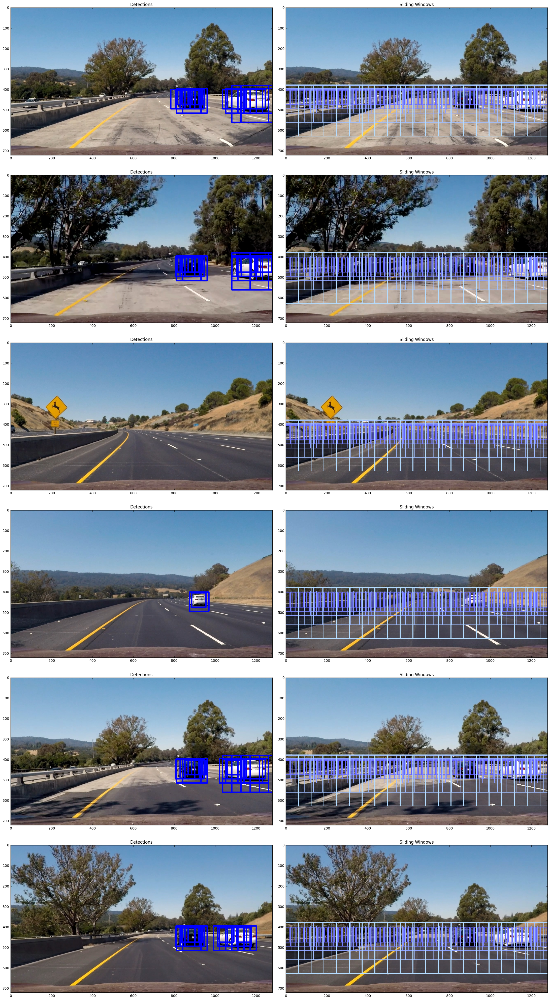

In [80]:
import time
%matplotlib inline

test_images_files = glob.glob('test_images/*.jpg')

window_sizes = [70, 94, 120, 180, 250]
overlaps = [0.75, 0.75, 0.75, 0.75, 0.75]
y_bounds =[[404,439],[400,447], [395,455], [380,470], [377,502]] 

fig, axes = plt.subplots(len(test_images_files), 2, figsize=(22, 40))
fig.tight_layout()

for i, file in enumerate(test_images_files):
    image = image_read(file)
    
    on_windows, debug_windows = find_cars(image, clf, X_scaler,
                                          window_sizes=window_sizes,
                                          overlaps=overlaps,
                                          y_bounds=y_bounds,
                                          debug=True)
    
    detections_img = draw_boxes(image, on_windows, color=(0, 0, 255), thick=5)                   

    debug_windows_img = image

    for k, d_window in enumerate(debug_windows):
        debug_windows_img = draw_boxes(debug_windows_img, 
                                       d_window, color=(100+k*20, 100+k*30, 255), thick=2)                    
    
    axes[i,0].imshow(detections_img)
    axes[i,0].set_title("Detections")
  
    axes[i,1].imshow(debug_windows_img)
    axes[i,1].set_title("Sliding Windows")
    
    plt.savefig('./output_images/sliding_windows.png', transparent=True)

In [48]:
# Calculate performance of the detector.
t1 = time.time()
on_windows = find_cars(image, clf, X_scaler,
                       window_sizes=window_sizes,
                       overlaps=overlaps,
                       y_bounds=y_bounds,
                       debug=False)
t2 = time.time()
print('Time to detect cars in image', round(t2-t1, 3))

Time to detect cars in image 2.251


#### Correct/Mitigate false positives

Build a heat-map from detections in order to combine overlapping detections and remove false positives.

In [81]:
from scipy.ndimage.measurements import label

def add_heat(heatmap, bbox_list):
    # Iterate through list of bboxes
    for box in bbox_list:
        # Add += 1 for all pixels inside each bbox
        # Assuming each "box" takes the form ((x1, y1), (x2, y2))
        heatmap[box[0][1]:box[1][1], box[0][0]:box[1][0]] += 1

    # Return updated heatmap
    return heatmap# Iterate through list of bboxes
    
def apply_threshold(heatmap, threshold):
    # Zero out pixels below the threshold
    heatmap[heatmap <= threshold] = 0
    # Return thresholded map
    return heatmap

def draw_labeled_bboxes(img, labels):
    # Iterate through all detected cars
    for car_number in range(1, labels[1]+1):
        # Find pixels with each car_number label value
        nonzero = (labels[0] == car_number).nonzero()
        # Identify x and y values of those pixels
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Define a bounding box based on min/max x and y
        bbox = ((np.min(nonzerox), np.min(nonzeroy)), (np.max(nonzerox), np.max(nonzeroy)))
        # Draw the box on the image
        cv2.rectangle(img, bbox[0], bbox[1], (0,0,255), 6)
    # Return the image
    return img

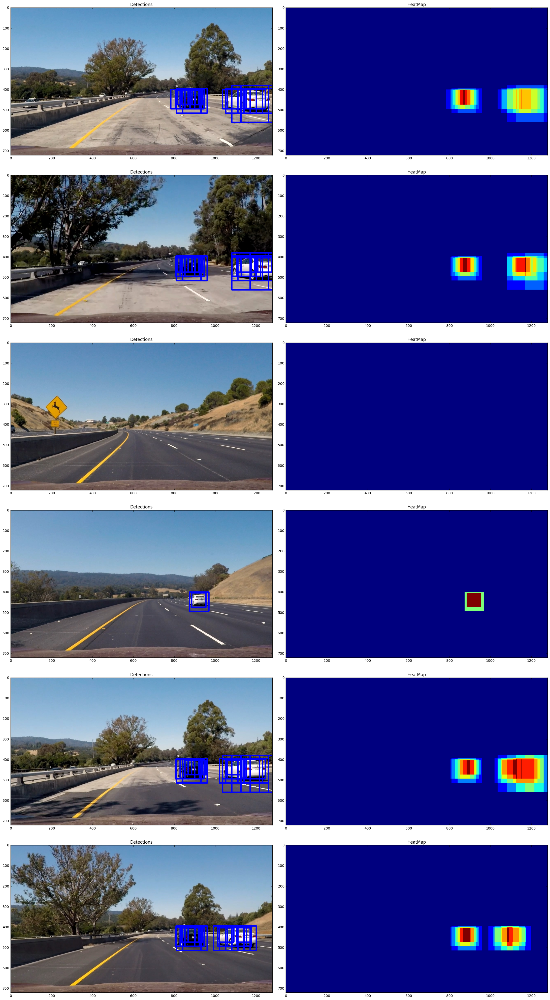

In [82]:
# Show heatmaps
test_images_files = glob.glob('test_images/*.jpg')

fig, axes = plt.subplots(len(test_images_files), 2, figsize=(22, 40))
fig.tight_layout()

for i, file in enumerate(test_images_files):
    image = image_read(file)
    
    on_windows = find_cars(image, clf, X_scaler,
                           window_sizes=window_sizes,
                           overlaps=overlaps,
                           y_bounds=y_bounds,
                           debug=False)
    
    detections_img = draw_boxes(image, on_windows, color=(0, 0, 255), thick=5)                   

    heatmap = np.zeros_like(image[:,:,0]).astype(np.float)                 
    
    heatmap = add_heat(heatmap, on_windows)
    
    axes[i,0].imshow(detections_img)
    axes[i,0].set_title("Detections")
  
    axes[i,1].imshow(heatmap)
    axes[i,1].set_title("HeatMap")
    
    plt.savefig('./output_images/heatmaps.png', transparent=True)

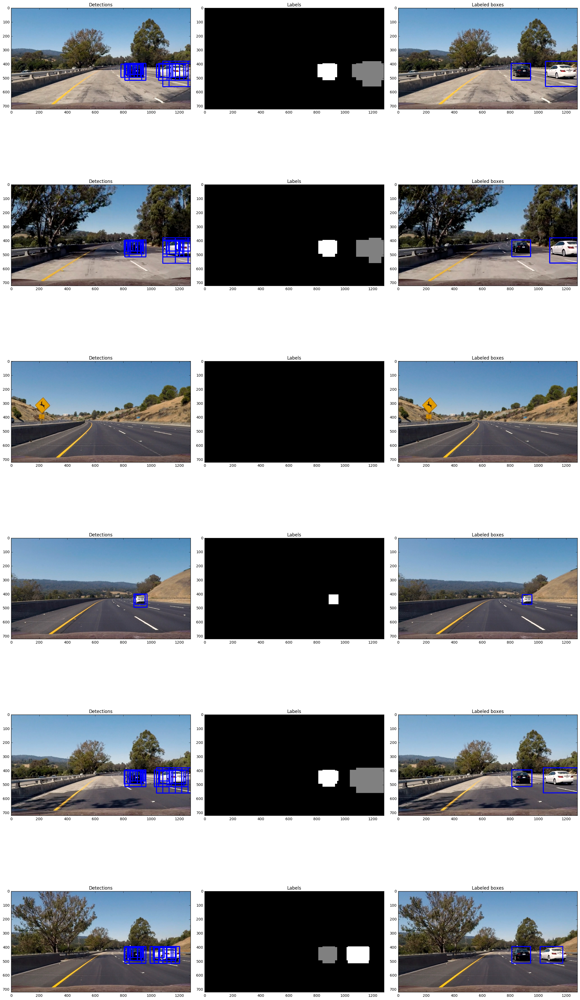

In [84]:
# Show labels
test_images_files = glob.glob('test_images/*.jpg')

fig, axes = plt.subplots(len(test_images_files), 3, figsize=(22, 40))
fig.tight_layout()

for i, file in enumerate(test_images_files):
    image = image_read(file)
    
    on_windows = find_cars(image, clf, X_scaler,
                           window_sizes=window_sizes,
                           overlaps=overlaps,
                           y_bounds=y_bounds,
                           debug=False)
    
    detections_img = draw_boxes(image, on_windows, color=(0, 0, 255), thick=5)                   

    heatmap = np.zeros_like(image[:,:,0]).astype(np.float) 
    
    heatmap = add_heat(heatmap, on_windows)
    
    heatmap = apply_threshold(heatmap, 1)
    labels = label(heatmap)
    
    axes[i,0].imshow(detections_img)
    axes[i,0].set_title("Detections")
  
    axes[i,1].imshow(labels[0], cmap='gray')
    axes[i,1].set_title("Labels")
    
    labeled_boxes_img = np.copy(image)
    labeled_boxes_img = draw_labeled_bboxes(labeled_boxes_img, labels)
    
    axes[i,2].imshow(labeled_boxes_img)
    axes[i,2].set_title("Labeled boxes")
    
    plt.savefig('./output_images/labels.png', transparent=True)

In [69]:
# Vehicle tracker using a 'retention' heatmap. In each frame, add the detected boxes to
# the heat map and apply a threshold. Many detections in the same area in a single
# frame would be labeled or may detections over multiple frames in the same
# area as well. 
class HeatMapTracker:
    def __init__(self, image_like, threshold=5):
        # 'Retention' heatmap. In each frame we will add heat to this heatmap for each 
        # effectively integrating the detections over multiple frames.
        self.ret_heatmap = np.zeros_like(image_like, dtype=np.float)
        self.threshold = threshold
        self.labels = None

    def update(self, detection_boxes):    
     
        # Cool the heatmap in each frame
        self.ret_heatmap -= 1
        # Clip the heatmap between a maximum and a minimum
        self.ret_heatmap = np.clip(self.ret_heatmap, 0, 15)
        # Add 1 to the heatmap for the area in each detection box.     
        self.ret_heatmap =  add_heat(self.ret_heatmap, detection_boxes)
        # Apply the configured threshold before assigning labels in the heatmap.
        heatmap_thresh = apply_threshold(self.ret_heatmap.copy(), self.threshold)
        # Asigning a label to each of hot region in the thresholded heatmap
        self.labels = label(heatmap_thresh)
        
        return self.labels

## Video Pipeline

In [72]:
heatmap_tracker = None

def process_pipeline(image):
    global heatmap_tracker
    
    window_sizes = [70, 94, 120, 180, 250]
    overlaps = [0.75, 0.75, 0.75, 0.75, 0.75]
    y_bounds =[[404,439],[400,447], [395,455], [380,470], [377,502]] 
    
    if heatmap_tracker is None:
        heatmap_tracker = HeatMapTracker(image[:,:,0], 5)    
    
    # Sliding window car detector
    on_windows = find_cars(image, clf, X_scaler,
                           window_sizes=window_sizes,
                           overlaps=overlaps,
                           y_bounds=y_bounds,
                           debug=False)
    
    # Compute a 'retention' heatmap.
    labels = heatmap_tracker.update(on_windows)
    
    final_image = np.copy(image)
    
    #Draw labeled boxes
    final_image = draw_labeled_bboxes(final_image, labels)
    
    return final_image

In [73]:
from moviepy.editor import VideoFileClip

input_file='project_video.mp4'
output_file='./project_video_out.mp4'
clip = VideoFileClip(input_file)
out_clip = clip.fl_image(process_pipeline) 
%time out_clip.write_videofile(output_file, audio=False)

[MoviePy] >>>> Building video ./project_video_out.mp4
[MoviePy] Writing video ./project_video_out.mp4


100%|█████████▉| 1260/1261 [45:40<00:02,  2.19s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: ./project_video_out.mp4 

CPU times: user 45min 24s, sys: 6.42 s, total: 45min 30s
Wall time: 45min 42s
